In [34]:
import datashader as ds, pandas as pd, colorcet as cc



In [37]:
import pandas as pd
import numpy as np
from collections import OrderedDict as odict

num=10000
np.random.seed(1)

dists = {cat: pd.DataFrame(odict([('x',np.random.normal(x,s,num)), 
                                  ('y',np.random.normal(y,s,num)), 
                                  ('val',val), 
                                  ('cat',cat)]))      
         for x,  y,  s,  val, cat in 
         [(  2,  2, 0.03, 10, "d1"), 
          (  2, -2, 0.10, 20, "d2"), 
          ( -2, -2, 0.50, 30, "d3"), 
          ( -2,  2, 1.00, 40, "d4"), 
          (  0,  0, 3.00, 50, "d5")] }

df = pd.concat(dists,ignore_index=True)
df["cat"]=df["cat"].astype("category")

In [38]:
df.tail()

,x,y,val,cat
49995,-1.397579,0.610189,50,d5
49996,-2.649610,3.080821,50,d5
49997,1.933360,0.243676,50,d5
49998,4.306374,1.032139,50,d5
49999,-0.493567,-2.242669,50,d5


CPU times: total: 5.55 s
Wall time: 6.31 s


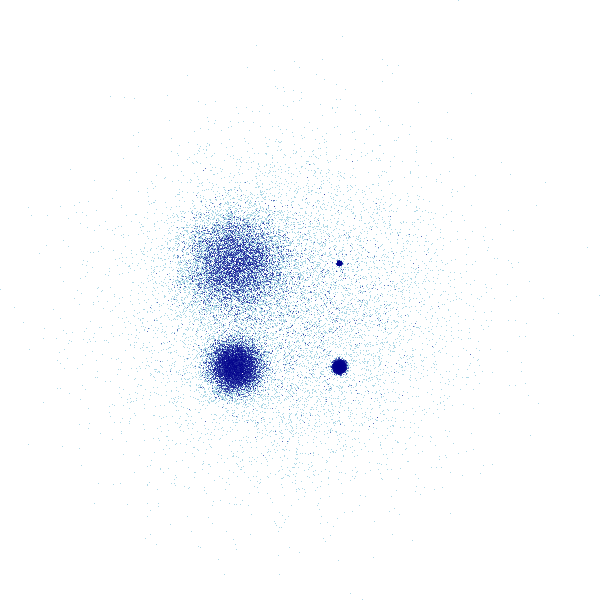

In [39]:
import datashader as ds
import datashader.transfer_functions as tf

%time tf.shade(ds.Canvas().points(df,'x','y'))

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
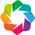

:DynamicMap   []
   :RGB   [x,y]   (R,G,B,A)

In [40]:
import holoviews as hv
from holoviews.operation.datashader import datashade
hv.extension("bokeh")

datashade(hv.Points(df))

In [41]:
canvas = ds.Canvas(plot_width=300, plot_height=300, 
                   x_range=(-8,8), y_range=(-8,8), 
                   x_axis_type='linear', y_axis_type='linear')

In [42]:
canvas.points(df, 'x', 'y', agg=ds.count())

<xarray.DataArray (y: 300, x: 300)>
array([[0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint32)
Coordinates:
  * x        (x) float64 -7.973 -7.92 -7.867 -7.813 ... 7.813 7.867 7.92 7.973
  * y        (y) float64 -7.973 -7.92 -7.867 -7.813 ... 7.813 7.867 7.92 7.973

count(),any(),mean('y'),50- mean('val')

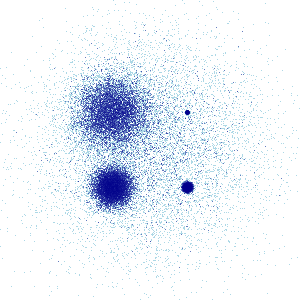
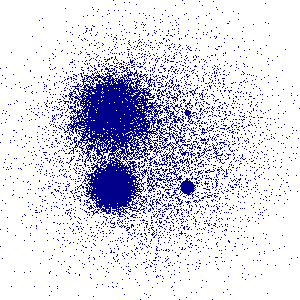
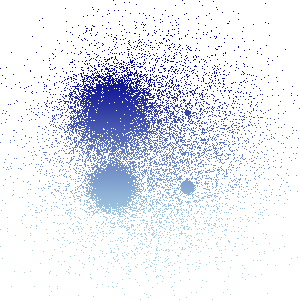
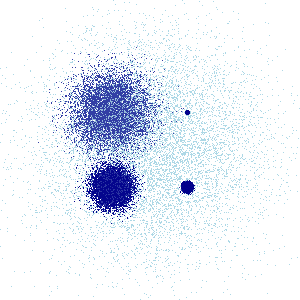

In [43]:
tf.Images(tf.shade(   canvas.points(df,'x','y', ds.count()),     name="count()"),
          tf.shade(   canvas.points(df,'x','y', ds.any()),       name="any()"),
          tf.shade(   canvas.points(df,'x','y', ds.mean('y')),   name="mean('y')"),
          tf.shade(50-canvas.points(df,'x','y', ds.mean('val')), name="50- mean('val')"))

In [46]:
aggc = canvas.points(df, 'x', 'y', ds.by('cat', ds.count()))
aggc

<xarray.DataArray (y: 300, x: 300, cat: 5)>
array([[[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]],

       [[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]],

       [[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
...
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]],

       [[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]],

       [[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]]], dtype=uint32)
Coordinates:
  * x        (x) float64 -7.973 -7.92 -7.867 -7.813 ... 7.813 7.867 7.92 7.973
  * y        (y) float64 -7.973 -7.92 -7.867 -7.813 ... 7.813 7.867 7.92 7.973
  * cat      (cat) <U2 'd1' 'd2' 'd3' 'd4' 'd5'

Category d3,Categories d3 and d5

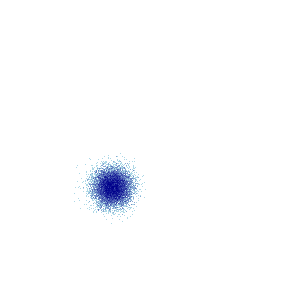
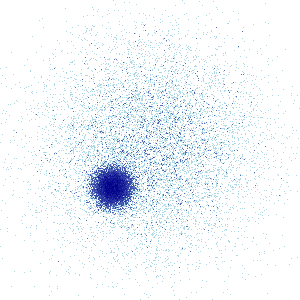

In [47]:
agg_d3_d5=aggc.sel(cat=['d3', 'd5']).sum(dim='cat').astype('uint32')

tf.Images(tf.shade(aggc.sel(cat='d3'), name="Category d3"),
          tf.shade(agg_d3_d5,          name="Categories d3 and d5"))          

In [48]:
categorizer = ds.category_binning('val', lower=10, upper=50, nbins=4, include_under=False, include_over=False)

agg3D = canvas.points(df, 'x', 'y', ds.by(categorizer, ds.count()))
agg3D

<xarray.DataArray (y: 300, x: 300, val: 5)>
array([[[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]],

       [[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]],

       [[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
...
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]],

       [[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]],

       [[0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        ...,
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0],
        [0, 0, 0, 0, 0]]], dtype=uint32)
Coordinates:
  * x        (x) float64 -7.973 -7.92 -7.867 -7.813 ... 7.813 7.867 7.92 7.973
  * y        (y) float64 -7.973 -7.92 -7.867 -7.813 ... 7.813 7.867 7.92 7.973
  * val      (val) int32 0 1 2 3 4

In [49]:
modulo_categorizer = ds.category_modulo('val', modulo=7, offset=0)

agg3D_modulo = canvas.points(df, 'x', 'y', ds.by(modulo_categorizer, ds.mean('x')))
agg3D_modulo

<xarray.DataArray (y: 300, x: 300, val: 7)>
array([[[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
...
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]],

       [[nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        ...,
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan],
        [nan, nan, nan, ..., nan, nan, nan]]])
Coordinates:
  * x        (x) float64 -7.973 -7.92 -7.867 -7.813 ... 7.813 7.867 7.92 7.973
  * y        (y) float64 -7.973 -7.92 -7.867 -7.813 ... 7.813 7.867 7.92 7.973
  * val      (val) int32 0 1 2 3 4 5 6

99th Percentile,Numpy square ufunc,Numpy sin ufunc

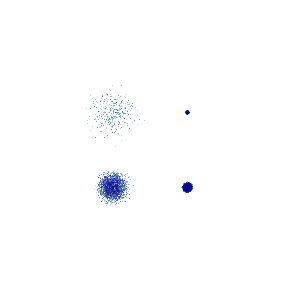
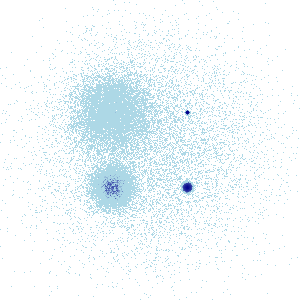
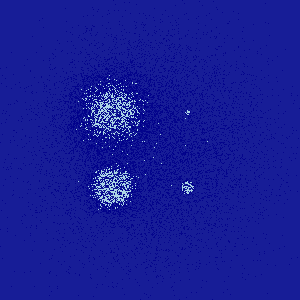

In [50]:
agg  = canvas.points(df, 'x', 'y')

tf.Images(tf.shade(agg.where(agg>=np.percentile(agg,99)), name="99th Percentile"),
          tf.shade(np.power(agg,2),                       name="Numpy square ufunc"),
          tf.shade(np.sin(agg),                           name="Numpy sin ufunc"))

d3+d5 where d3==d5,d1+d2+d3+d4+d5 where d3==d5

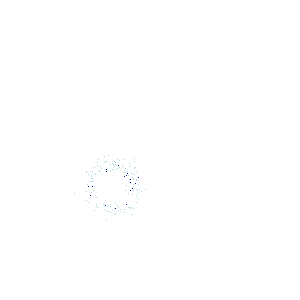
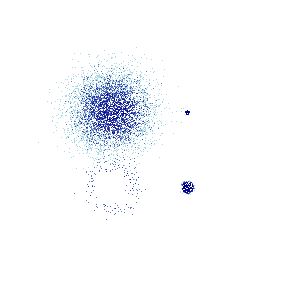

In [51]:
sel1 = agg_d3_d5.where(aggc.sel(cat='d3') == aggc.sel(cat='d5')).astype('uint32')
sel2 =       agg.where(aggc.sel(cat='d3') == aggc.sel(cat='d5')).astype('uint32')

tf.Images(tf.shade(sel1, name="d3+d5 where d3==d5"),
          tf.shade(sel2, name="d1+d2+d3+d4+d5 where d3==d5"))

Original image,spread 1px,spread 2px,spread square

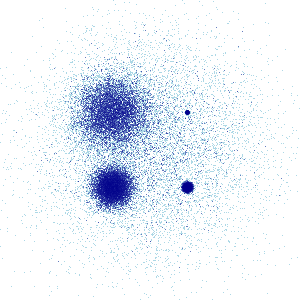
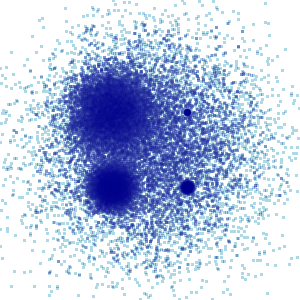
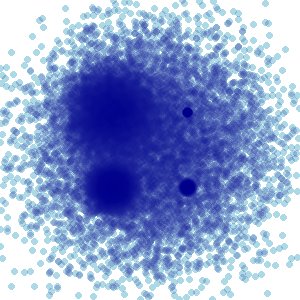
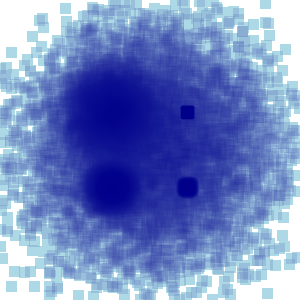

In [52]:
img = tf.shade(agg, name="Original image")
tf.Images(img,
          tf.shade(tf.spread(agg,       name="spread 1px")),
          tf.shade(tf.spread(agg, px=3, name="spread 2px")),
          tf.shade(tf.spread(agg, px=5, shape='square', name="spread square")))

"darkred, yellow","yellow, orange red, dark purple",Bokeh RdBu9,Black

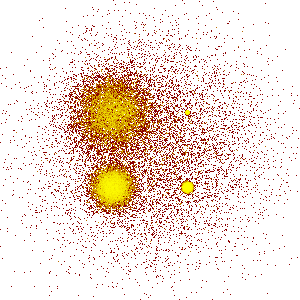
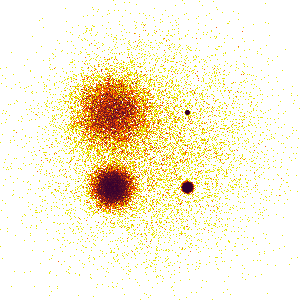
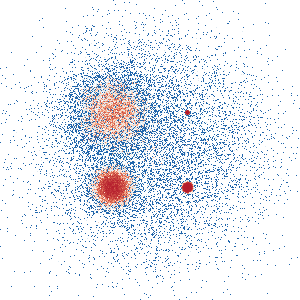
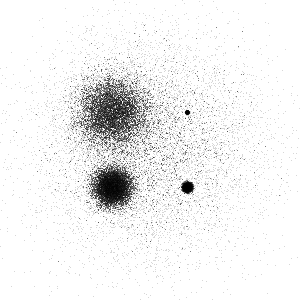

In [53]:
from bokeh.palettes import RdBu9
tf.Images(tf.shade(agg,cmap=["darkred", "yellow"], name="darkred, yellow"),
          tf.shade(agg,cmap=[(230,230,0), "orangered", "#300030"], name="yellow, orange red, dark purple"), 
          tf.shade(agg,cmap=list(RdBu9), name="Bokeh RdBu9"),
          tf.shade(agg,cmap="black", name="Black"))

Default color key,Custom color key

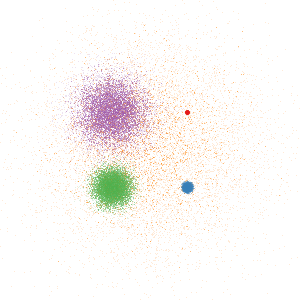
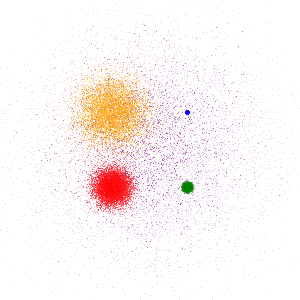

In [54]:
color_key = dict(d1='blue', d2='green', d3='red', d4='orange', d5='purple')

tf.Images(tf.shade(aggc, name="Default color key"),
          tf.shade(aggc, color_key=color_key, name="Custom color key"))

Custom categories - 2D,All categories - 2D

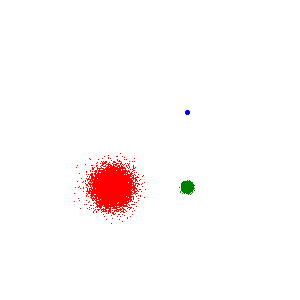
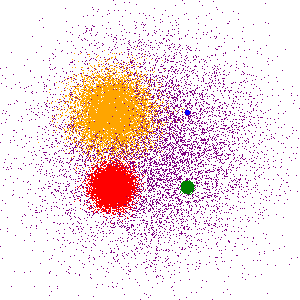

In [55]:
aggc_2d = canvas.points(df, 'x', 'y', ds.min('val'))

custom_cats_colorkey = {10: 'blue', 20: 'green', 30: 'red'}
all_cats_colorkey = {10: 'blue', 20: 'green', 30: 'red', 40: 'orange', 50: 'purple'}

tf.Images(tf.shade(aggc_2d, color_key=custom_cats_colorkey, name="Custom categories - 2D"),
          tf.shade(aggc_2d, color_key=all_cats_colorkey, name="All categories - 2D"))

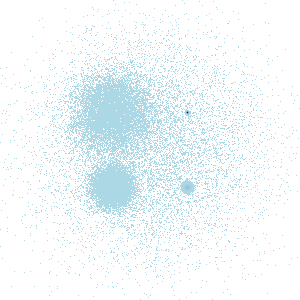

In [56]:
tf.shade(agg,how='linear')

In [57]:
top15=agg.values.flat[np.argpartition(agg.values.flat, -15)[-15:]]
print(sorted(top15))
print(sorted(np.round(top15*255.0/agg.values.max()).astype(int)))

[342, 345, 345, 351, 355, 357, 363, 392, 399, 405, 1075, 1148, 1169, 1172, 3918]
[22, 22, 22, 23, 23, 23, 24, 26, 26, 26, 70, 75, 76, 76, 255]


In [58]:
print(np.log1p(sorted(top15)))

[5.83773045 5.84643878 5.84643878 5.86363118 5.87493073 5.88053299
 5.89715387 5.97380961 5.99146455 6.00635316 6.98100574 7.04664728
 7.06475903 7.06731985 8.2735918 ]


log,eq_hist,23rd root

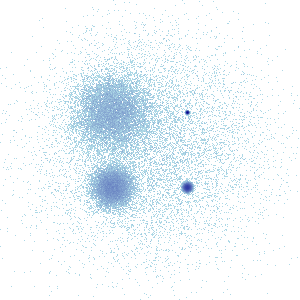
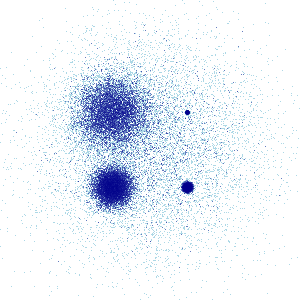
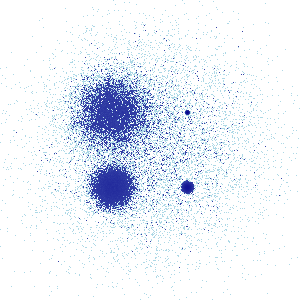

In [59]:
tf.Images(tf.shade(agg,how='log', name="log"),
          tf.shade(agg,how='eq_hist', name="eq_hist"),
          tf.shade(agg,how=lambda d, m: np.where(m, np.nan, d)**(1/23.), name="23rd root"))

eq_hist rescale_discrete_levels=False,eq_hist rescale_discrete_levels=True

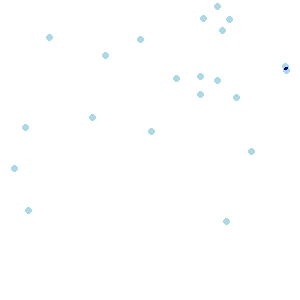
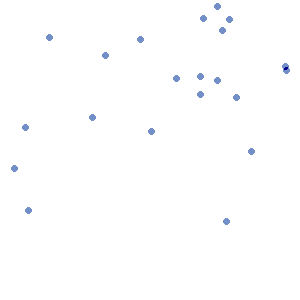

In [60]:
zoom_agg = ds.Canvas(plot_width=300, plot_height=300, x_range=(1.92,1.95), y_range=(1.92,1.95)).points(df, 'x', 'y')
zoom = tf.spread(zoom_agg, px=3)

tf.Images(tf.shade(zoom, how='eq_hist', name="eq_hist rescale_discrete_levels=False", rescale_discrete_levels=False),
          tf.shade(zoom, how='eq_hist', name="eq_hist rescale_discrete_levels=True",  rescale_discrete_levels=True))

gb 0 20,gb 50 200,Green 10 20

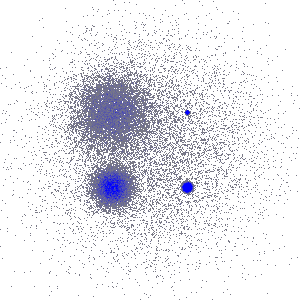
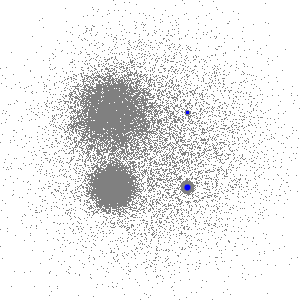
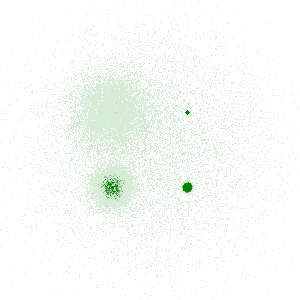

In [61]:
tf.Images(tf.shade(agg,cmap=["grey", "blue"], name="gb 0 20",   span=[0,20],   how="linear"),
          tf.shade(agg,cmap=["grey", "blue"], name="gb 50 200", span=[50,200], how="linear"),
          tf.shade(agg,cmap="green",        name="Green 10 20", span=[10,20],  how="linear"))

Green,No min_alpha,Small alpha range

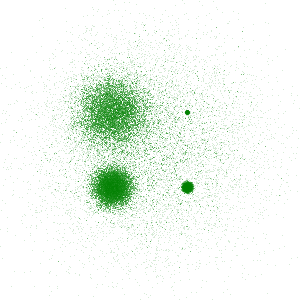
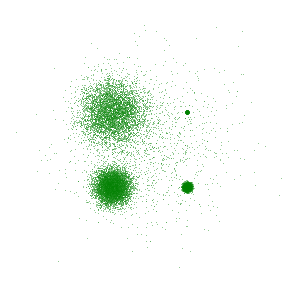
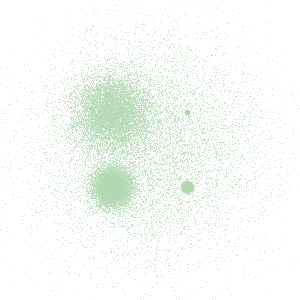

In [62]:
tf.Images(tf.shade(agg,cmap="green", name="Green"),
          tf.shade(agg,cmap="green", name="No min_alpha",      min_alpha=0), 
          tf.shade(agg,cmap="green", name="Small alpha range", min_alpha=50, alpha=80))

"g 0,20","g 10,20","g 10,20 0"

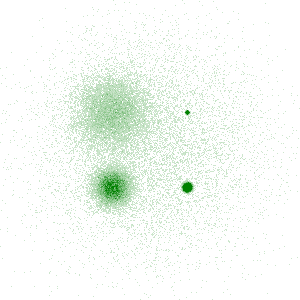
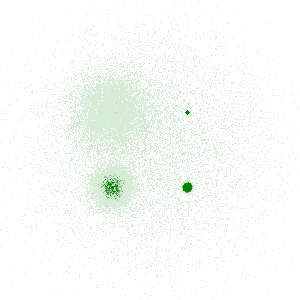
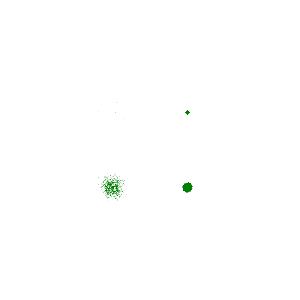

In [63]:
tf.Images(tf.shade(agg,cmap="green", name="g 0,20",    span=[ 0,20], how="linear"),
          tf.shade(agg,cmap="green", name="g 10,20",   span=[10,20], how="linear"),
          tf.shade(agg,cmap="green", name="g 10,20 0", span=[10,20], how="linear", min_alpha=0))

,,

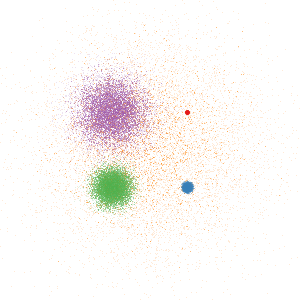
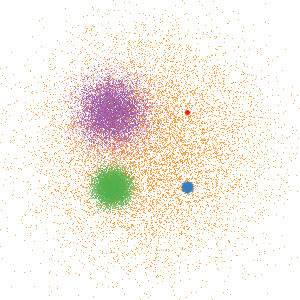
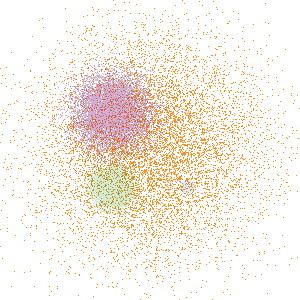

In [64]:
agg_c = canvas.points(df,'x','y', ds.by('cat', ds.count()))
agg_s = canvas.points(df,'x','y', ds.by("cat", ds.sum("val")))
agg_m = canvas.points(df,'x','y', ds.by("cat", ds.mean("val")))

tf.Images(tf.shade(agg_c), tf.shade(agg_s), tf.shade(agg_m))

Sequential,DivergingW,DivergingB

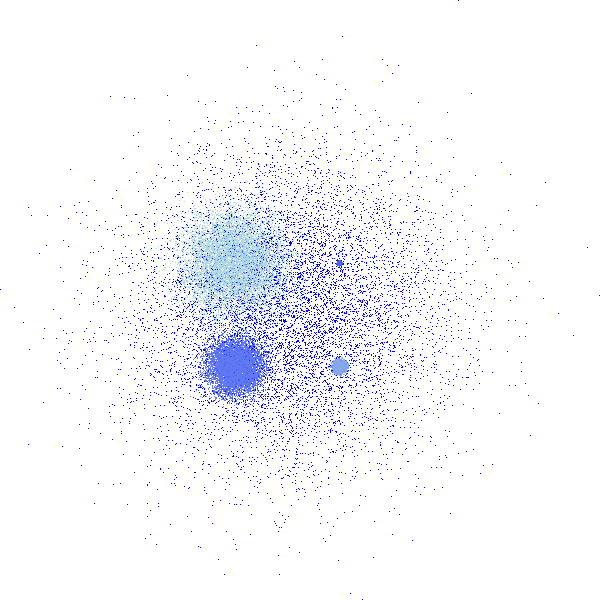
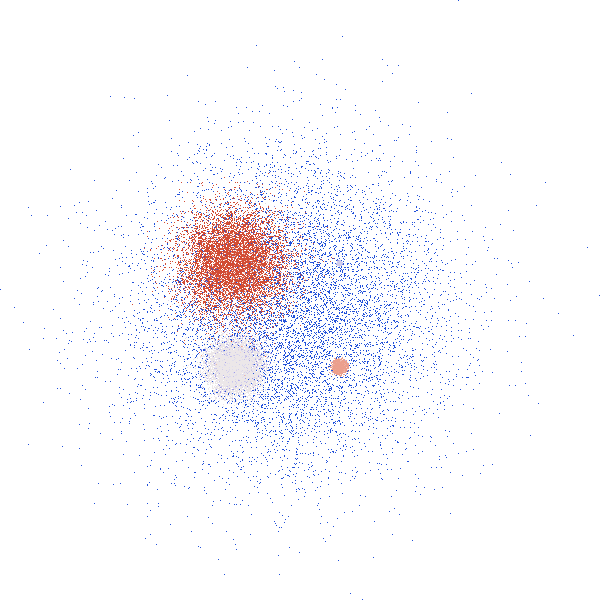
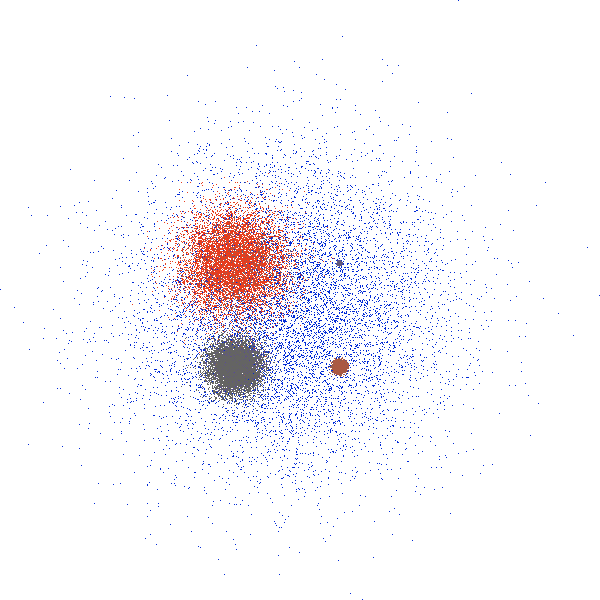

In [65]:
from colorcet import coolwarm, CET_D8
dfn = df.copy()
dfn.val.replace({20:-20, 30:0, 40:-40}, inplace=True)
aggn = ds.Canvas().points(dfn,'x','y', agg=ds.mean("val"))

tf.Images(tf.shade(aggn, name="Sequential", cmap=["lightblue","blue"], how="linear"),
          tf.shade(aggn, name="DivergingW", cmap=coolwarm[::-1], span=(-50,50), how="linear"),
          tf.shade(aggn, name="DivergingB", cmap=CET_D8[::-1],   span=(-50,50), how="linear"))

count,sum,sum baseline=0

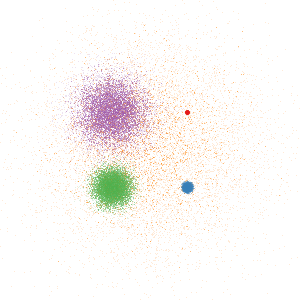
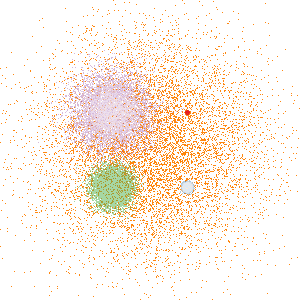
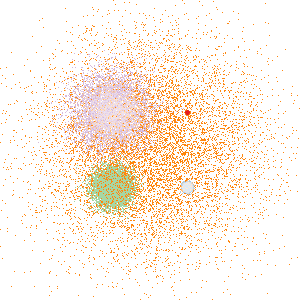

In [66]:
agg_c = canvas.points(dfn,'x','y', ds.by('cat', ds.count()))
agg_s = canvas.points(dfn,'x','y', ds.by("cat", ds.sum("val")))
agg_m = canvas.points(dfn,'x','y', ds.by("cat", ds.mean("val")))

tf.Images(tf.shade(agg_c, name="count"), 
          tf.shade(agg_s, name="sum"), 
          tf.shade(agg_s, name="sum baseline=0", color_baseline=0))

Original image,Aggregate spreading,RGB spreading

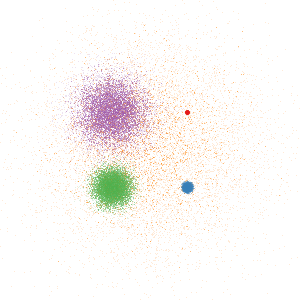
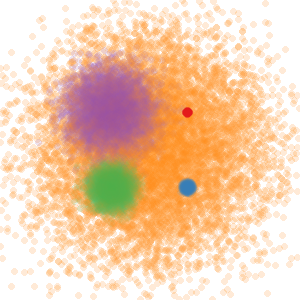
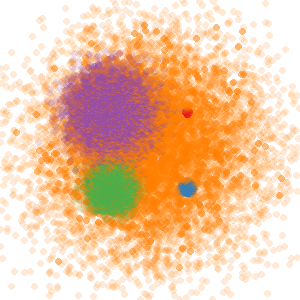

In [67]:
img = tf.shade(aggc, name="Original image")
tf.Images(img,
          tf.shade(tf.spread(aggc, px=3, name="Aggregate spreading")),
          tf.spread(img, px=3, name="RGB spreading"))

Black bg,Sum d2 and d3 colors,d2+d3 saturated

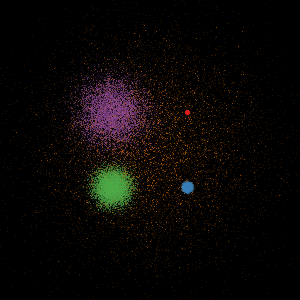
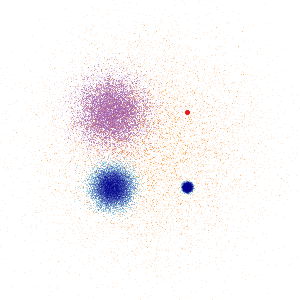
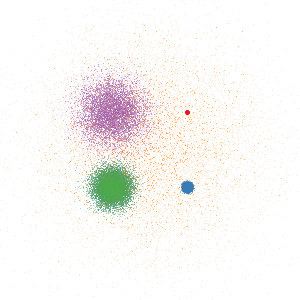

In [68]:
sum_d2_d3 = aggc.sel(cat=['d2', 'd3']).sum(dim='cat').astype('uint32')

tf.Images(tf.set_background(img,"black", name="Black bg"),
          tf.stack(img,tf.shade(sum_d2_d3), name="Sum d2 and d3 colors"),
          tf.stack(img,tf.shade(sum_d2_d3), name="d2+d3 saturated", how='saturate')) 

In [69]:
points = hv.Points(df.sample(10000))

points

:Points   [x,y]   (val,cat)

In [71]:
points.data.head()

,x,y,val,cat
37998,-1.794928,4.408181,40,d4
16484,2.162613,-1.996706,20,d2
4199,1.970395,1.969477,10,d1
2508,2.031205,2.014974,10,d1
27826,-2.597463,-2.615660,30,d3


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
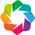

In [73]:
import holoviews as hv
import holoviews.operation.datashader as hd
hd.shade.cmap=["lightblue", "darkblue"]
hv.extension("bokeh", "matplotlib") 

In [74]:
hv.output(backend="matplotlib")
agg = ds.Canvas().points(df,'x','y')
hd.datashade(points)  +  hd.shade(hv.Image(agg)) + hv.RGB(np.array(tf.shade(agg).to_pil()), bounds=(-10,-10,10,10))

Error: Backend 'matplotlib' does not exist
For help with hv.util.output call help(hv.util.output)


:Layout
   .DynamicMap.I :DynamicMap   []
      :RGB   [x,y]   (R,G,B,A)
   .RGB.I        :RGB   [x,y]   (R,G,B,A)
   .RGB.II       :RGB   [x,y]   (R,G,B,A)

In [75]:
hv.output(backend="bokeh")
hd.datashade(points)

:DynamicMap   []
   :RGB   [x,y]   (R,G,B,A)

In [76]:
datashaded = hd.datashade(points, aggregator=ds.count_cat('cat')).redim.range(x=(-5,5),y=(-5,5))
hd.dynspread(datashaded, threshold=0.8, how='over', max_px=5).opts(height=500,width=500)

:DynamicMap   []
   :RGB   [x,y]   (R,G,B,A)

In [77]:
from datashader.colors import Sets1to3

datashaded  = hd.datashade(points, aggregator=ds.count_cat('cat'), color_key=Sets1to3)
gaussspread = hd.dynspread(datashaded, threshold=0.50, how='over').opts(plot=dict(height=400,width=400))

color_key = [(name,color) for name,color in zip(["d1","d2","d3","d4","d5"], Sets1to3)]
color_points = hv.NdOverlay({n: hv.Points([0,0], label=str(n)).opts(color=c,size=0) for n,c in color_key})

color_points * gaussspread

:DynamicMap   []
   :Overlay
      .NdOverlay.D1 :NdOverlay   [Element]
         :Points   [x,y]
      .RGB.I        :RGB   [x,y]   (R,G,B,A)

In [78]:
from holoviews.streams import RangeXY

pts = hd.datashade(points, width=400, height=400)

rasterized = hd.rasterize(points).opts(tools=['hover'])

quadmesh =  hv.QuadMesh(hd.aggregate(points, width=12, height=12, dynamic=False)) \
            .opts(tools=['hover'], alpha=0, hover_alpha=0.2)

dynamic = hv.util.Dynamic(hd.aggregate(points, width=12, height=12, streams=[RangeXY]), 
                          operation=hv.QuadMesh) \
          .opts(tools=['hover'], alpha=0, hover_alpha=0.2)

rasterized.relabel("Pixel hover").opts(cmap=["lightblue","darkblue"], cnorm="eq_hist") + \
(pts * quadmesh).relabel("Fixed square hover") + \
(pts * dynamic).relabel("Dynamic square hover")

:Layout
   .DynamicMap.Pixel_hover          :DynamicMap   []
      :Image   [x,y]   (x_y Count)
   .DynamicMap.Fixed_square_hover   :DynamicMap   []
      :Overlay
         .RGB.I      :RGB   [x,y]   (R,G,B,A)
         .QuadMesh.I :QuadMesh   [x,y]   (x_y Count)
   .DynamicMap.Dynamic_square_hover :DynamicMap   []
      :Overlay
         .RGB.I      :RGB   [x,y]   (R,G,B,A)
         .QuadMesh.I :QuadMesh   [x,y]   (x_y Count)

In [35]:
canvas = ds.Canvas(plot_width=300, plot_height=300, 
                   x_range=(-8,8), y_range=(-8,8), 
                   x_axis_type='linear', y_axis_type='linear')

In [81]:
import matplotlib.pyplot as plt
from datashader.mpl_ext import dsshow, alpha_colormap

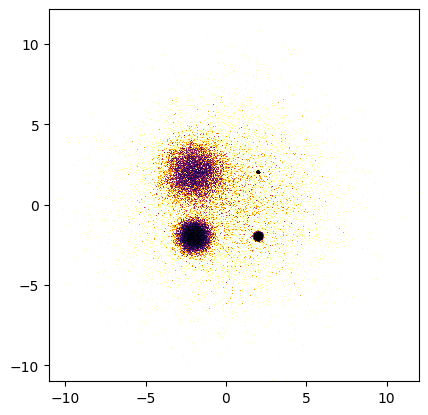

In [82]:
dsshow(df, ds.Point('x', 'y'), norm='eq_hist', cmap="inferno_r");

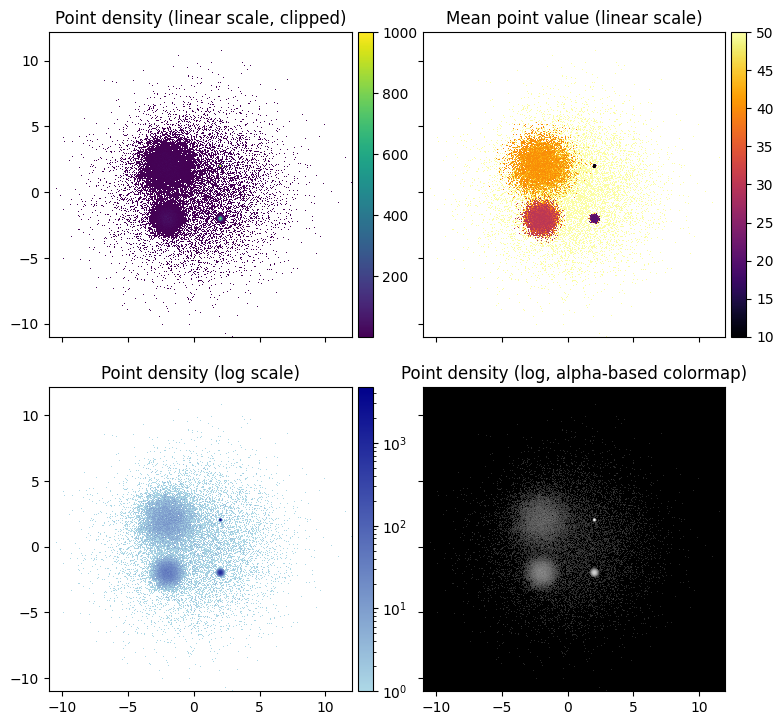

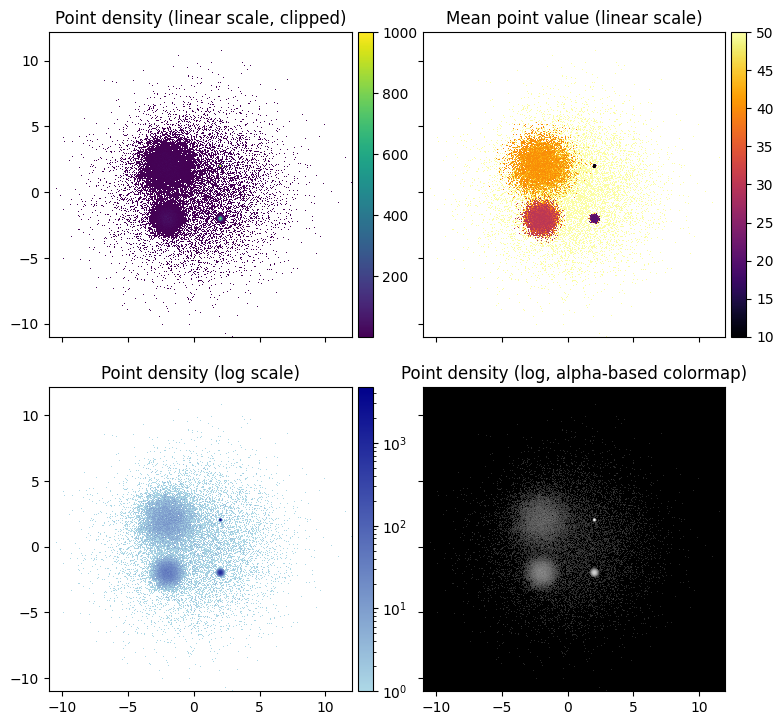

In [83]:
from mpl_toolkits.axes_grid1 import ImageGrid

fig = plt.figure(figsize=(9, 9))

# Here, we create a grid of axes using ImageGrid
# https://matplotlib.org/3.1.0/gallery/axes_grid1/demo_axes_grid.html 
grid = ImageGrid(fig, 111, nrows_ncols=(2, 2), axes_pad=0.5, share_all=True,
                 cbar_location="right", cbar_mode="each", cbar_size="5%", cbar_pad="2%")

artist0 = dsshow(df, ds.Point('x', 'y'), ds.count(), vmax=1000, aspect='equal', ax=grid[0])

plt.colorbar(artist0, cax=grid.cbar_axes[0]);
grid[0].set_title('Point density (linear scale, clipped)');

artist1 = dsshow(df, ds.Point('x', 'y'), ds.mean('val'), cmap='inferno', aspect='equal', ax=grid[1])
plt.colorbar(artist1, cax=grid.cbar_axes[1]);
grid[1].set_title('Mean point value (linear scale)');

dsblue=['lightblue', 'darkblue']
artist2 = dsshow(df, ds.Point('x', 'y'), ds.count(), norm='log', cmap=dsblue, aspect='equal', ax=grid[2])
plt.colorbar(artist2, cax=grid.cbar_axes[2]);
grid[2].set_title('Point density (log scale)');

artist3 = dsshow(df, ds.Point('x', 'y'), norm='log', cmap=alpha_colormap('#ffffff', 40, 255), ax=grid[3])
grid[3].set_facecolor('#000000');
grid.cbar_axes[3].set_visible(False);
grid[3].set_title('Point density (log, alpha-based colormap)');
fig

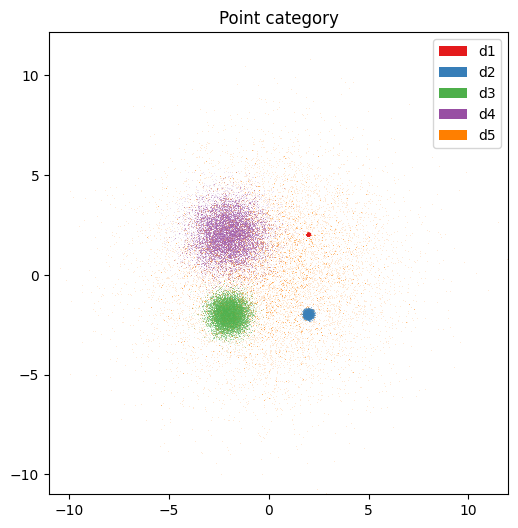

In [84]:
plt.figure(figsize=(6, 6))
ax = plt.subplot(111)

artist4 = dsshow(
    df, 
    ds.Point('x', 'y'), 
    ds.count_cat('cat'),
    ax=ax
)
plt.legend(handles=artist4.get_legend_elements());
plt.title('Point category');

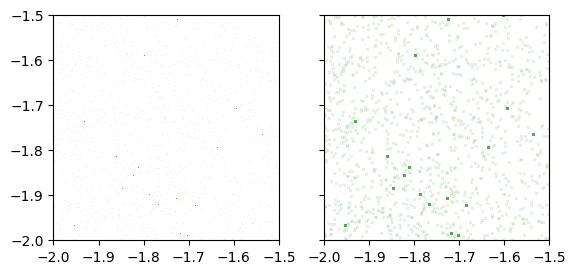

In [85]:
from functools import partial

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, sharex=True, sharey=True)

dsshow(df, ds.Point('x', 'y'), ds.count_cat('cat'), ax=ax1);

dsshow(df, ds.Point('x', 'y'), ds.count_cat('cat'), shade_hook=tf.dynspread, 
       x_range=(-2, -1.5), y_range=(-2, -1.5), ax=ax2);

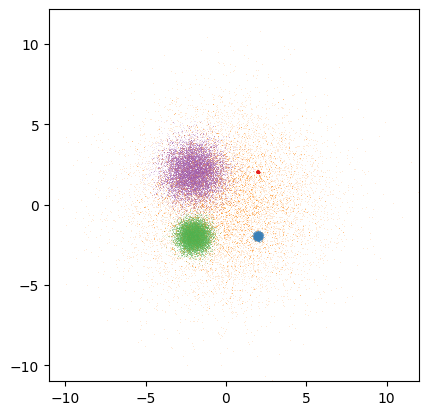

In [86]:
dsshow(df, ds.Point('x', 'y'), ds.count_cat('cat'), shade_hook=partial(tf.dynspread, threshold=0.50, how='over'));